# Analyse the Extracted Samples

In [1]:
# import necessary modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import pickle
import warnings
import tqdm
import pandas as pd
import librosa
import librosa.display as display
import biosppy
from scipy import signal
from scipy.stats import zscore
from scipy.io import wavfile
from scipy.fft import fft,fftfreq
from scipy.fftpack import fft

warnings.filterwarnings("ignore")

%matplotlib inline
import matplotlib as mlp
mlp.rc("xtick",labelsize=10)
mlp.rc("ytick",labelsize=10)
mlp.rc("axes",labelsize=11)
plt.rcParams["figure.figsize"] = [11,5]
plt.rcParams["figure.dpi"] = 300

CURR_DIR = os.getcwd()

/home/rimesh/Files/softwareFiles/python/ml/lib/python3.6/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit


In [2]:
# make necessary definitions

# directories definitions
MAIN_DIR = "."
if os.path.basename(os.getcwd())!="Silent-Interface-for-IOT-Devices":
    os.chdir("..")

DATA_DIR = os.path.join(MAIN_DIR,"dataset")
NEW_DATA_DIR = os.path.join(MAIN_DIR, "new dataset")
FIG_DIR = os.path.join(MAIN_DIR,"figures")
PICKLE_DIR = os.path.join(MAIN_DIR,"pickles")
os.makedirs(FIG_DIR,exist_ok=True)
os.makedirs(PICKLE_DIR,exist_ok=True)

# hardware definitions
"""
https://docs.openbci.com/docs/02Cyton/CytonDataFormat#:~:text=By%20default%2C%20our%20Arduino%20sketch,of%200.02235%20microVolts%20per%20count
"""
SAMPLING_RATE = 250 #Hz
NUM_CHANNELS = 8 
ADC_RESOLUTION = 24 #bits
ADC_GAIN = 24.0
REF_VOLTAGE = 4.5 #Volts
SCALE_FACTOR = (REF_VOLTAGE/float((pow(2,23))-1)/ADC_GAIN)*1000000.0 #micro-volts

# dataset definitions
SPEAKER = ["RL","RN","SR","US"]
SESSION = ["session1","session2","session3"]
MODE = ["mentally","mouthed","audible"]
SENTENCES =["अबको समय सुनाउ","एउटा सङ्गित बजाउ","आजको मौसम बताउ","बत्तिको अवस्था बदल","पङ्खाको स्तिथी बदल"]
WORDS = ["समय","सङ्गित","मौसम","बत्ति","पङ्खा"]

SENTENCE_LABEL= np.array(SENTENCES)[[0,1,2,0,3,1,0,3,0,0,1,1,3,3,4,4,2,3,1,2,2,2,4,4,4]]
WORD_LABEL= np.array(WORDS)[[4,0,3,1,0,1,1,0,4,0,3,2,4,4,2,1,4,1,2,2,2,0,3,3,3]]

NEW_LABEL = np.array(SENTENCES)[[3, 2, 1, 4, 0, 3, 2, 1, 4, 0, 3, 2, 1, 4, 0]]

LABELS = {"word":WORD_LABEL,"sentence":SENTENCE_LABEL}

# a function to save plotted figures
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(FIG_DIR, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)
    

##### File parser

In [3]:
listOfFiles = glob.glob(NEW_DATA_DIR+"/**/*.txt",recursive=True)
# listOfFiles = glob.glob(NEW_DATA_DIR+"/**/*.txt",recursive=True)
print(len(listOfFiles))

0


In [38]:
def parser(files,FILTER=True, maxSignalLength = 0):
    """
    parser function to extract utterances from .txt file and store them in a dictionary
    """
    
    dataset = {"data":[], "speaker":[], "labels":[], "session":[], "filename":[]}

    def get_data(file):
        session = file.split("/")[-2]
        speaker = file.split("/")[-3]
        filename = file.split("/")[-1]
        signal = read_data(file)
#         print(len(signal), "file : ", filename)
        
        # only take files with 15 labels or max labels for utterance in a stream.         
        if(len(signal) != len(NEW_LABEL)) and FILTER :
            return
        
        dataset["data"].extend(signal)
        dataset["speaker"].extend([speaker]*len(signal))
        dataset["session"].extend([session]*len(signal))
        dataset["labels"].extend(NEW_LABEL)
        dataset["filename"].extend([filename]*len(signal))
        
    def read_data(file):
        f = open(file, 'r')
        contents = map(lambda x : x.strip(), f.readlines())
        #the file starts with '%' and some instruction before data and removing these data 
        frames_original = list(filter(lambda x : x and x[0] != '%', contents))[1:]
        #the data row contains channels info digital trigger and accelerometer info separated by comma
        frames_original = list(map(lambda s : list(map( lambda ss: ss.strip(), s.split(','))), frames_original))
        # (8 channels) + digital triggers
        # the digital trigger is in a[16], used to indicate the utterance
        frames = list(map(lambda a: list(map(float, a[1:9])) + [float(a[16])] , frames_original))
        frames = np.array(frames)
        indices = []
        signal = []
        for index,f in enumerate(frames[:,-1]):
            if(bool(f) ^ bool(frames[(index+1) if ((index+1)<len(frames)) else index,-1]) ):
                indices.append(index)
                if len(indices)>1 and len(indices)%2==0:
                    signalTrueLength = indices[len(indices)-1] - indices[len(indices)-2]
                    padWidth = 0
                    if (maxSignalLength != 0) and  (signalTrueLength < maxSignalLength):
                        padWidth = maxSignalLength - signalTrueLength
                    
                    signalStartIndex = indices[len(indices)-2] - int(np.floor(padWidth/2))
                    signalEndIndex = indices[len(indices)-1] + int(np.ceil(padWidth/2))
                    signal.append(frames[signalStartIndex : signalEndIndex, :-1])   
        
        # convert to microVolts and return
        return np.array(signal)*SCALE_FACTOR
        
    for file,i in zip(files,tqdm.tqdm(range(1,len(files)+1),desc="PARSING DATA")):
        get_data(file)
    
    return dataset

###### Data Imports

In [18]:
pickleDataFile =  "new_data_dict.pickle" 
dataNeedsUpdate = True
if (pickleDataFile in os.listdir(PICKLE_DIR)) and (not dataNeedsUpdate):
    #TODO : implement MLTD here ???
    parsedData = pickle.load(open(os.path.join(PICKLE_DIR, pickleDataFile), "rb"))
else : 
    parsedData = parser(listOfFiles)
    pickle.dump(parsedData, open(os.path.join(PICKLE_DIR, pickleDataFile), "wb"))

PARSING DATA:  99%|█████████▉| 103/104 [04:54<00:02,  2.86s/it]


In [19]:
print(type(parsedData))
print(parsedData.keys())
print([len(parsedData[i]) for i in parsedData.keys()])

<class 'dict'>
dict_keys(['data', 'speaker', 'labels', 'session', 'filename'])
[1455, 1455, 1455, 1455, 1455]


#### Dataframe 

In [20]:
df_pickleDataFile = 'new_data_dict_dataframe.pickle'
df_dataNeedsUpdate = True
if df_pickleDataFile in os.listdir(PICKLE_DIR) and not df_dataNeedsUpdate:
    df = pd.read_pickle(os.path.join(PICKLE_DIR, df_pickleDataFile))
else :
    df = pd.DataFrame(parsedData)
    df.to_pickle(os.path.join(PICKLE_DIR, df_pickleDataFile))

In [24]:
(df["data"].iloc[0].shape)
df.shape


(1455, 5)

In [43]:
min([len(df["data"].iloc[i]) for i in range(df.shape[0]) ])

1875

##### taking surrounding emg to make the total signal of equal length

In [39]:
maxSignalLength = 1875 #from above
pickleDataFile =  "new_data_dict_equalmaxlen.pickle" 
dataNeedsUpdate = True
if (pickleDataFile in os.listdir(PICKLE_DIR)) and (not dataNeedsUpdate):
    #TODO : implement MLTD here ???
    parsedData = pickle.load(open(os.path.join(PICKLE_DIR, pickleDataFile), "rb"))
else : 
    parsedData = parser(listOfFiles, maxSignalLength = maxSignalLength)
    pickle.dump(parsedData, open(os.path.join(PICKLE_DIR, pickleDataFile), "wb"))

PARSING DATA:  99%|█████████▉| 103/104 [04:47<00:02,  2.79s/it]


In [40]:
df_pickleDataFile = 'new_data_dict_dataframe_equalmaxlen.pickle'
df_dataNeedsUpdate = True
if df_pickleDataFile in os.listdir(PICKLE_DIR) and not df_dataNeedsUpdate:
    df = pd.read_pickle(os.path.join(PICKLE_DIR, df_pickleDataFile))
else :
    df = pd.DataFrame(parsedData)
    df.to_pickle(os.path.join(PICKLE_DIR, df_pickleDataFile))

In [41]:
df["data"].iloc[0]

array([[-296.67374373,  374.01287502,  158.81399014, ...,  677.14299872,
         -41.1475943 ,  155.25884041],
       [-297.82383266,  373.63669341,  157.31869336, ...,  675.75457121,
         -42.79877213,  153.90941933],
       [-300.08651023,  372.53905687,  154.41051095, ...,  672.97981169,
         -45.7938786 ,  150.9707652 ],
       ...,
       [-294.41455862,  375.58513689,  162.47856301, ...,  681.11130647,
         -39.22712871,  160.06199892],
       [-293.57422907,  375.25042825,  163.4587765 , ...,  681.9366621 ,
         -38.5146996 ,  160.93879194],
       [-295.67653724,  374.31514744,  160.72196474, ...,  679.42065021,
         -41.2655003 ,  158.3009041 ]])

##### Data info

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1455 entries, 0 to 1454
Data columns (total 5 columns):
data        1455 non-null object
speaker     1455 non-null object
labels      1455 non-null object
session     1455 non-null object
filename    1455 non-null object
dtypes: object(5)
memory usage: 57.0+ KB


In [31]:
df.head(5)

,data,speaker,labels,session,filename
0,"[[-299.5149691360221, 374.28616002074307, 156....",RL,बत्तिको अवस्था बदल,session1,OpenBCI-RAW-2021-06-05_14-21-12.txt
1,"[[-297.5590387010546, 376.81465745649876, 157....",RL,आजको मौसम बताउ,session1,OpenBCI-RAW-2021-06-05_14-21-12.txt
2,"[[-299.1612484144418, 367.9017683876924, 150.9...",RL,एउटा सङ्गित बजाउ,session1,OpenBCI-RAW-2021-06-05_14-21-12.txt
3,"[[-299.0908098603819, 359.47952630313057, 153....",RL,पङ्खाको स्तिथी बदल,session1,OpenBCI-RAW-2021-06-05_14-21-12.txt
4,"[[-305.0860104742547, 349.31965436592304, 141....",RL,अबको समय सुनाउ,session1,OpenBCI-RAW-2021-06-05_14-21-12.txt


In [32]:
df.tail(5)

,data,speaker,labels,session,filename
1300,"[[-957.1745153687317, -211.064205054397, -277....",US,बत्तिको अवस्था बदल,session6,OpenBCI-RAW-2021-06-03_10-54-07.txt
1301,"[[-970.784632265971, -219.32160302360094, -280...",US,आजको मौसम बताउ,session6,OpenBCI-RAW-2021-06-03_10-54-07.txt
1302,"[[-946.3826391259003, -186.25704289032285, -26...",US,एउटा सङ्गित बजाउ,session6,OpenBCI-RAW-2021-06-03_10-54-07.txt
1303,"[[-959.2409166813245, -191.79112963542772, -26...",US,पङ्खाको स्तिथी बदल,session6,OpenBCI-RAW-2021-06-03_10-54-07.txt
1304,"[[-933.8221811030426, -157.8417765710013, -251...",US,अबको समय सुनाउ,session6,OpenBCI-RAW-2021-06-03_10-54-07.txt


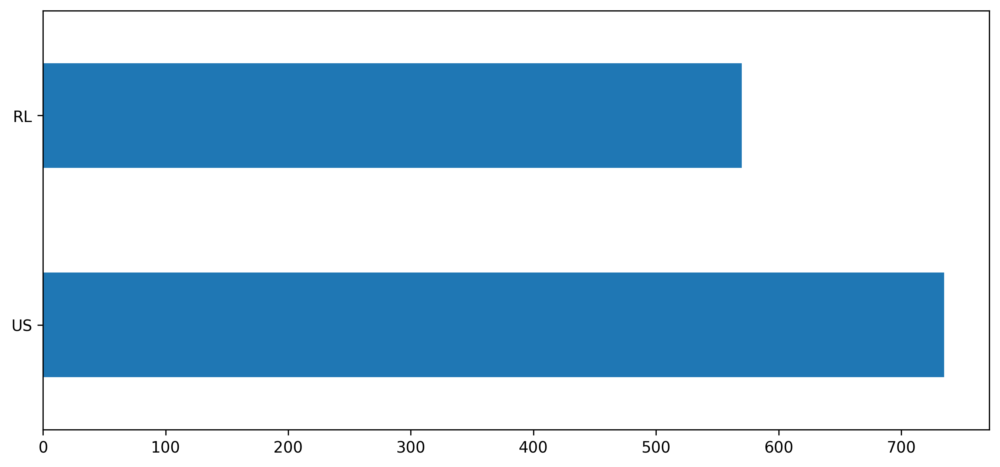

In [33]:
df["speaker"].value_counts().plot.barh()
plt.show()

## ANALYSE LENGTH OF SAMPLES

In [34]:
# all_sentences = df[df["utter_type"]=="sentence"]
all_sentences = df
all_sent_length = [x.shape[0]/SAMPLING_RATE for x in all_sentences["data"]]

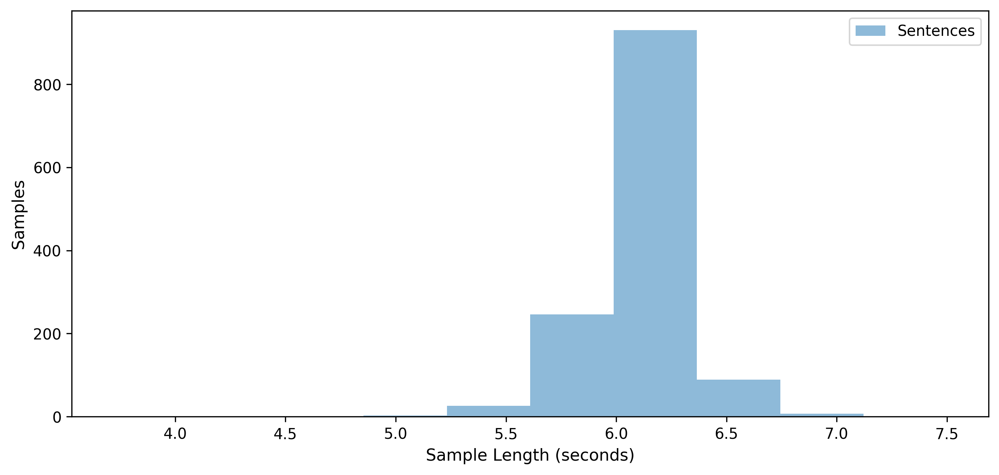

In [35]:
plt.hist(all_sent_length,alpha=0.5)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
plt.legend(["Sentences"])
# save_fig("length distribution")
plt.show()

In [36]:
# print("Max length of words utterances in seconds: %.2fs" % np.max(all_word_length))
# print("Min length of words utterances in seconds: %.2fs" % np.min(all_word_length))
# print("Avg length of words utterances in seconds: %.2fs" % np.mean(all_word_length))
# print("\n")
print("Max length of sentence utterances in seconds: %.2fs" % np.max(all_sent_length))
print("Min length of sentence utterances in seconds: %.2fs" % np.min(all_sent_length))
print("Avg length of sentence utterances in seconds: %.2fs" % np.mean(all_sent_length))

Max length of sentence utterances in seconds: 7.50s
Min length of sentence utterances in seconds: 3.72s
Avg length of sentence utterances in seconds: 6.12s


In [37]:
# all_sent_RL = df.query('utter_type=="sentence" and speaker=="RL"')
# all_sent_US = df.query('utter_type=="sentence" and speaker=="US"')

all_sent_RL = df.query('speaker=="RL"')
all_sent_US = df.query('speaker=="US"')

all_sent_length_RL = [x.shape[0]/SAMPLING_RATE for x in all_sent_RL["data"]]

all_sent_length_US = [x.shape[0]/SAMPLING_RATE for x in all_sent_US["data"]]


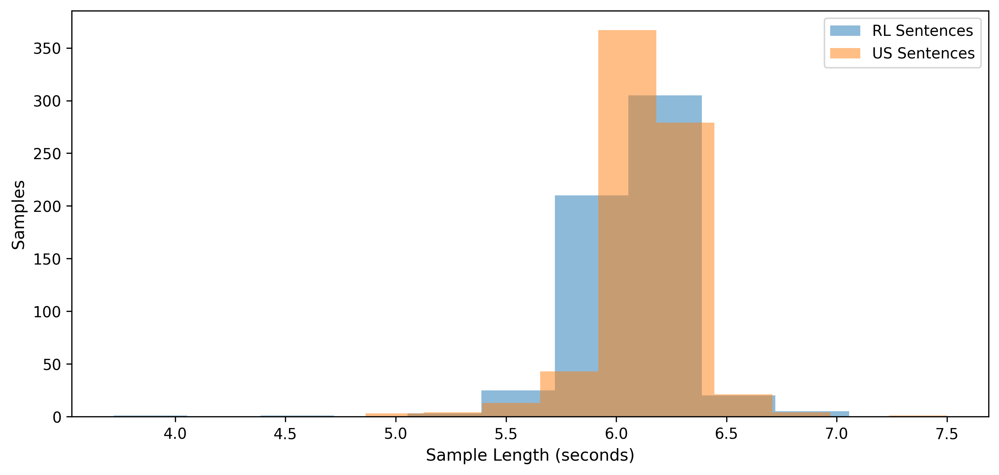

In [38]:
plt.hist(all_sent_length_RL,alpha=0.5)
plt.hist(all_sent_length_US,alpha=0.5)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
# save_fig("length distribution")
plt.legend(["RL Sentences","US Sentences"])
plt.show()

In [39]:
# SENTENCES =["अबको समय सुनाउ","एउटा सङ्गित बजाउ","आजको मौसम बताउ","बत्तिको अवस्था बदल","पङ्खाको स्तिथी बदल"]
# WORDS = ["समय","सङ्गित","मौसम","बत्ति","पङ्खा"]

all_sent_RL = df.query('speaker=="RL" and labels=="आजको मौसम बताउ"')
all_sent_US = df.query('speaker=="US" and labels=="आजको मौसम बताउ"')


all_sent_length_RL = [x.shape[0]/SAMPLING_RATE for x in all_sent_RL["data"]]

all_sent_length_US = [x.shape[0]/SAMPLING_RATE for x in all_sent_US["data"]]


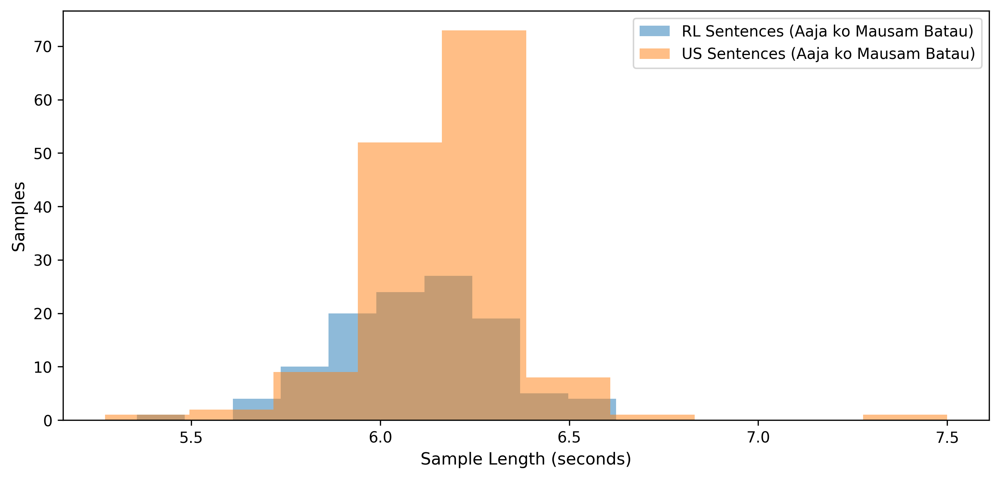

In [40]:
plt.hist(all_sent_length_RL,alpha=0.5)
plt.hist(all_sent_length_US,alpha=0.5)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
# save_fig("length distribution")
plt.legend(["RL Sentences (Aaja ko Mausam Batau)","US Sentences (Aaja ko Mausam Batau)"])
plt.show()

## SIGNAL ANALYSIS (RAW)

In [20]:
#access variable...
# xxx = 1
# sample_RL_audible = df.query('utter_type=="sentence" and mode=="audible" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
# sample_RL_mouthed = df.query('utter_type=="sentence" and mode=="mouthed" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
# sample_RL_mentally = df.query('utter_type=="sentence" and mode=="mentally" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]

# sample_US_audible = df.query('utter_type=="sentence" and mode=="audible" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
# sample_US_mouthed = df.query('utter_type=="sentence" and mode=="mouthed" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
# sample_US_mentally = df.query('utter_type=="sentence" and mode=="mentally" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]

#### Data Access

In [5]:
def get_sample(index, speaker, label = "आजको मौसम बताउ"):
    return df.query('speaker=="'+speaker+'" and labels=="'+ label+'"')["data"].iloc[index]

In [6]:
print("Length of RL samples in seconds : %.2f s" % (len(get_sample(1, 'RL', SENTENCES[0]))/SAMPLING_RATE))
print("Length of US samples in seconds : %.2f s" % (len(get_sample(1, 'US', SENTENCES[0]))/SAMPLING_RATE))

Length of RL samples in seconds : 6.27 s
Length of US samples in seconds : 6.23 s


### TIME SERIES PLOT

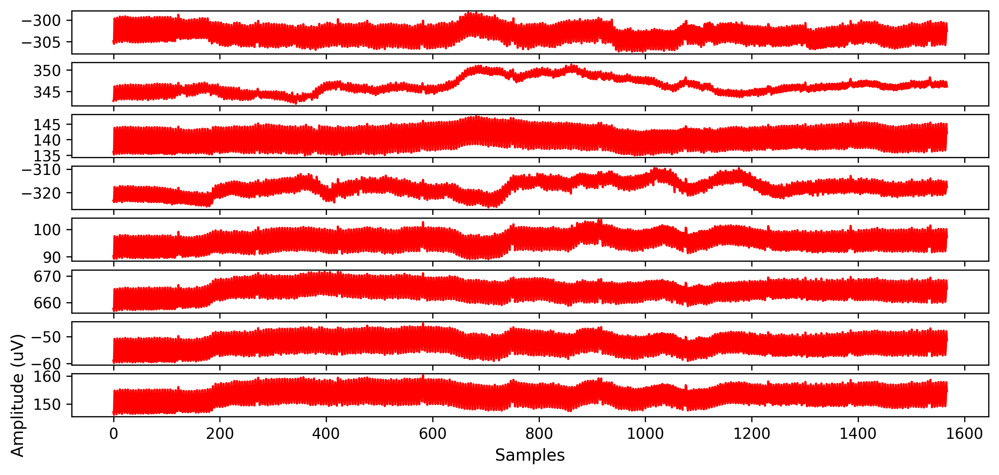

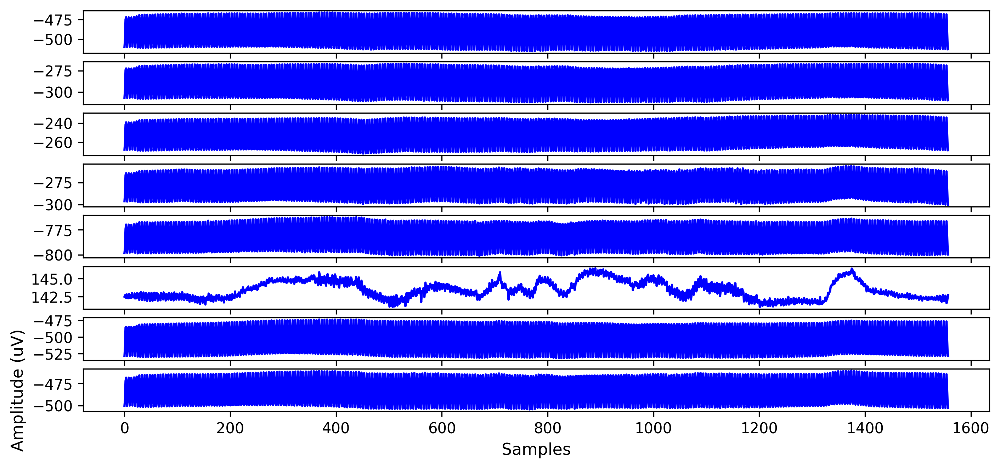

In [7]:
fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(get_sample(1, 'RL', SENTENCES[0])[:,i],"r")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()


fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(get_sample(1, 'US', SENTENCES[0])[:,i],"b")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()

In [8]:
print([max(get_sample(1, 'RL', SENTENCES[0])[:,i]) - min(get_sample(1, 'RL', SENTENCES[0])[:,i]) for i in range(8)])
print([max(get_sample(1, 'US', SENTENCES[0])[:,i]) - min(get_sample(1, 'US', SENTENCES[0])[:,i]) for i in range(8)])

[9.049771675719683, 9.09971385473699, 12.47252442662895, 16.80656914947633, 14.352019098758177, 14.92354381849384, 14.579839363258273, 14.025785129331496]
[48.95184830840361, 45.48263492461041, 40.496122262909665, 43.99231490075249, 38.96886947379937, 5.381193391552898, 57.93965064573598, 43.95234806081328]


### FFT

In [9]:
def FFT(data1, data2, MODE):
    plt.suptitle(MODE)
    plt.subplot(211).set_title("RL")
    N = len(data1)
    for i in range(NUM_CHANNELS):
        y = fft(zscore(data1[:,i]))
        x = fftfreq(N,1/SAMPLING_RATE)
        plt.plot(abs(x),abs(y),alpha=0.6)

    plt.ylabel("Amplitude (uV)")

    plt.subplot(212).set_title("US")
    N = len(data2)
    for i in range(NUM_CHANNELS):
        y = fft(zscore(data2[:,i]))
        x = fftfreq(N,1/SAMPLING_RATE)
        plt.plot(abs(x),abs(y),alpha=0.6)

    plt.ylabel("Amplitude (uV)")
    plt.title("US")
    plt.show()

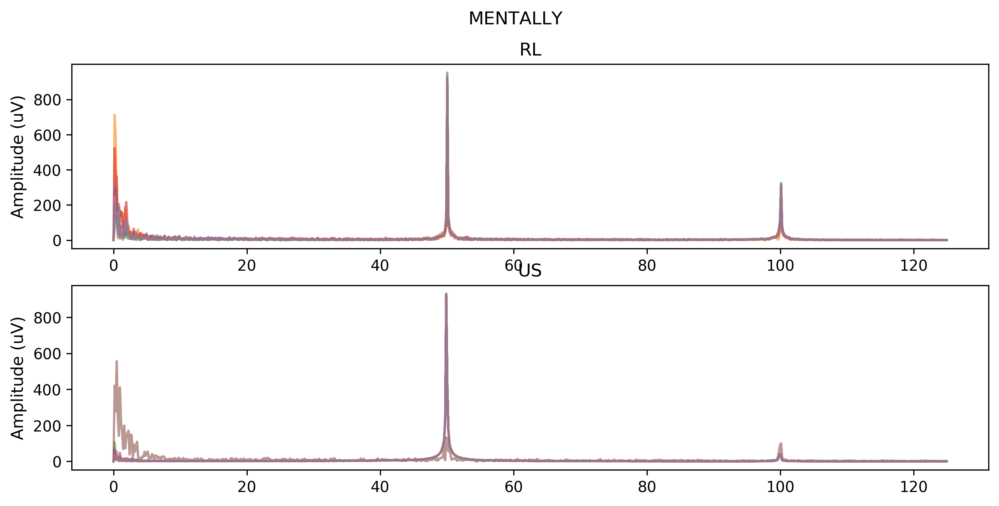

In [10]:
FFT(data1=get_sample(1, 'RL', SENTENCES[0]),data2=get_sample(1, 'US', SENTENCES[0]),MODE="MENTALLY")

In [11]:
print(len(get_sample(1, 'RL', SENTENCES[0])[:,0])); print(len(get_sample(1, 'US', SENTENCES[0])[:,0]))


1568
1558


### POWER SPECTRUM

In [13]:
def power_spec(data1,data2,MODE):
    plt.suptitle(MODE)
    plt.subplot(211).set_title("RL")
    for i in range(NUM_CHANNELS):
        power = biosppy.signals.tools.power_spectrum(data1[:,i],sampling_rate=SAMPLING_RATE)
        plt.plot(power[0],power[1],alpha=0.6)
    plt.ylabel("Power")

    plt.subplot(212).set_title("US")
    for i in range(NUM_CHANNELS):
        power = biosppy.signals.tools.power_spectrum(data2[:,i],sampling_rate=SAMPLING_RATE)
        plt.plot(power[0],power[1],alpha=0.6)
    plt.ylabel("Power")
    plt.title("US")
    plt.show()

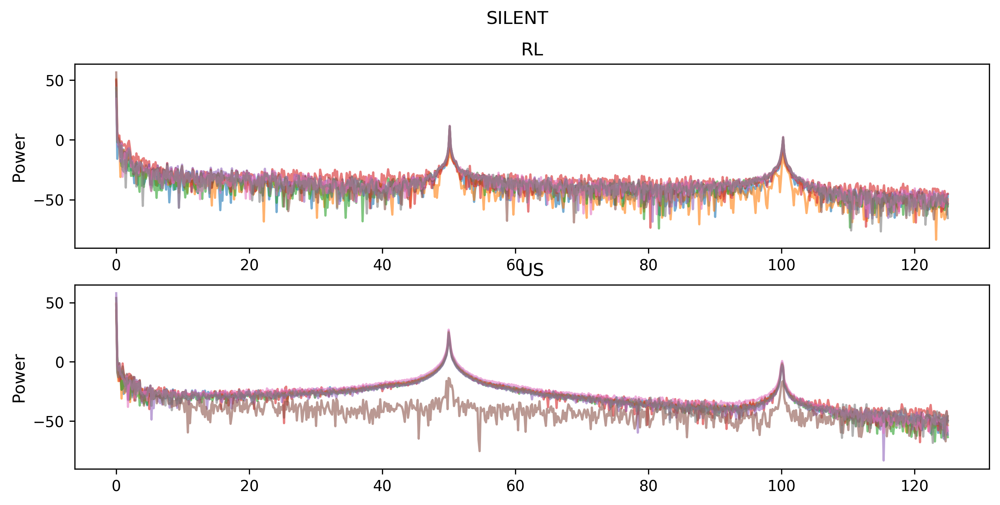

In [14]:
power_spec(data1=get_sample(1, 'RL', SENTENCES[0]),data2=get_sample(1, 'US', SENTENCES[0]),MODE="SILENT")

### STFT

In [12]:
def STFT(data1,data2,MODE,channel=4):
    plt.suptitle(MODE)
    plt.subplot(121).set_title("RL")
    f, t, Zxx = signal.stft(data1[:,channel], fs=SAMPLING_RATE, nperseg=50)
    plt.pcolormesh(t, f, 20*np.log10(abs(Zxx)), shading='gouraud',cmap="magma")
#     nperseg change garera herne
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
#     plt.ylim([0,20])
    plt.colorbar(format='%+2.0f dB')
    
    plt.subplot(122).set_title("US")
    f, t, Zxx = signal.stft(data2[:,channel], fs=SAMPLING_RATE, nperseg=50)
    plt.pcolormesh(t, f, 20*np.log10(abs(Zxx)), shading='gouraud',cmap="magma")
#     plt.colorbar()
#     plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
#     plt.ylim([0,20])
    plt.colorbar(format='%+2.0f dB')
    plt.show()

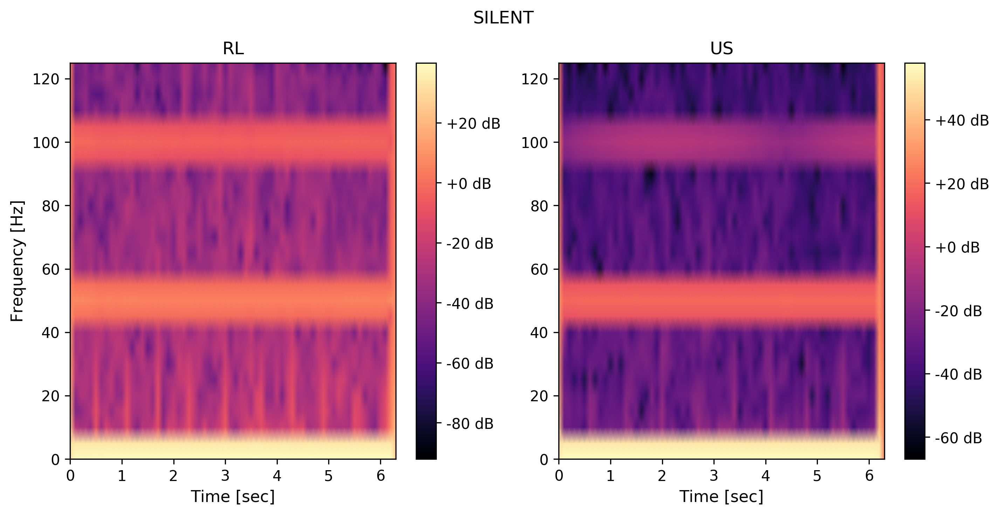

In [13]:
STFT(data1=get_sample(1, 'RL', SENTENCES[0]), data2=get_sample(1, 'US', SENTENCES[0]),MODE="SILENT")

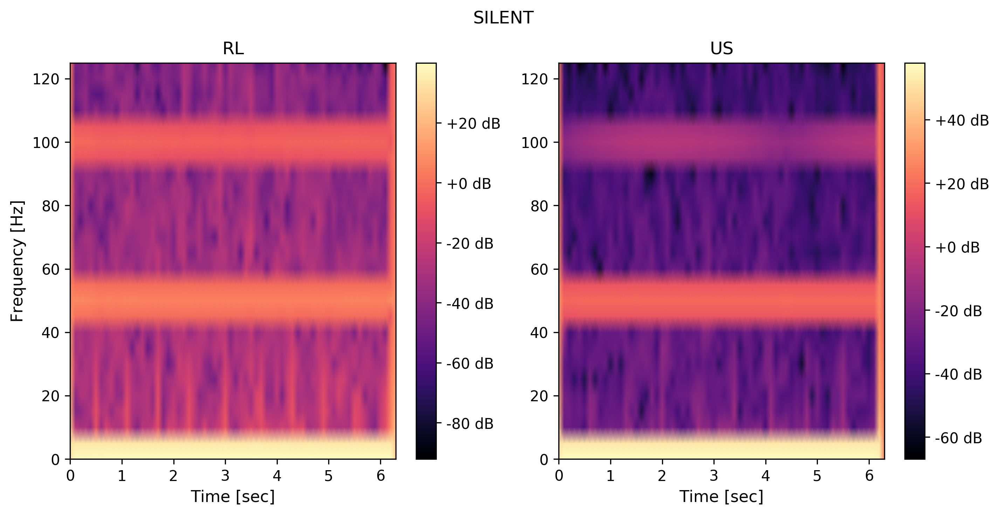

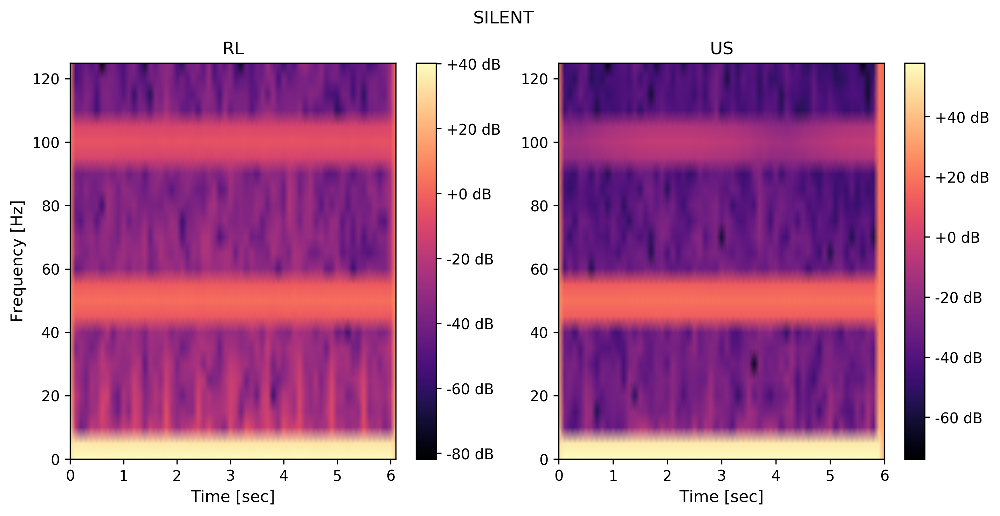

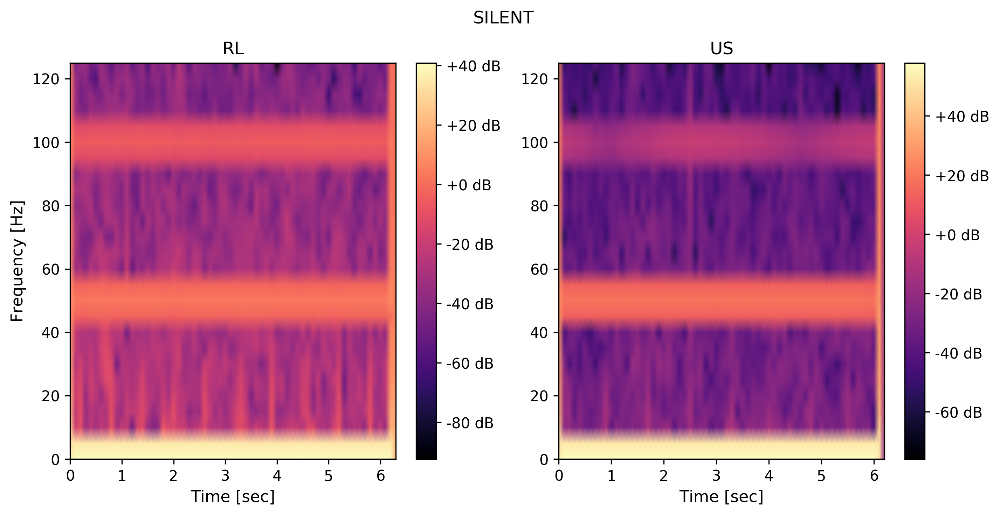

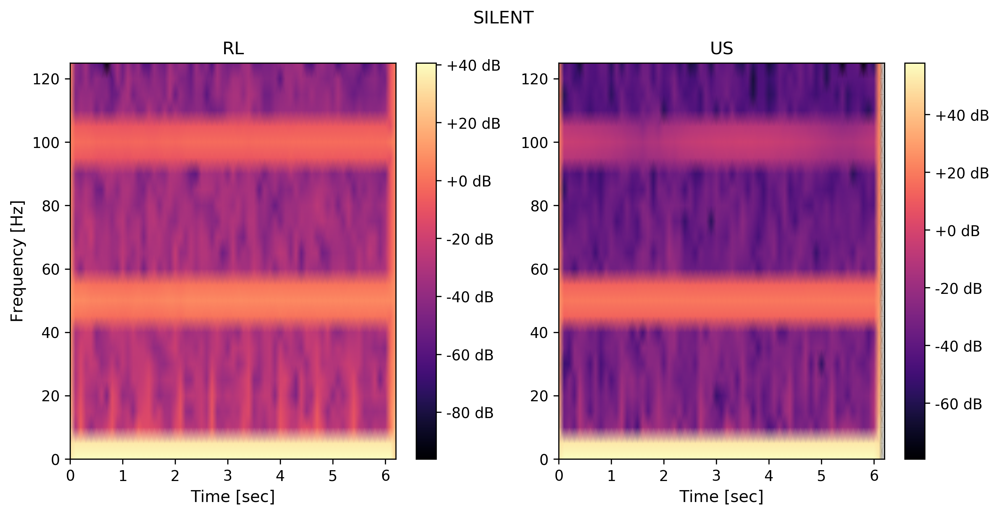

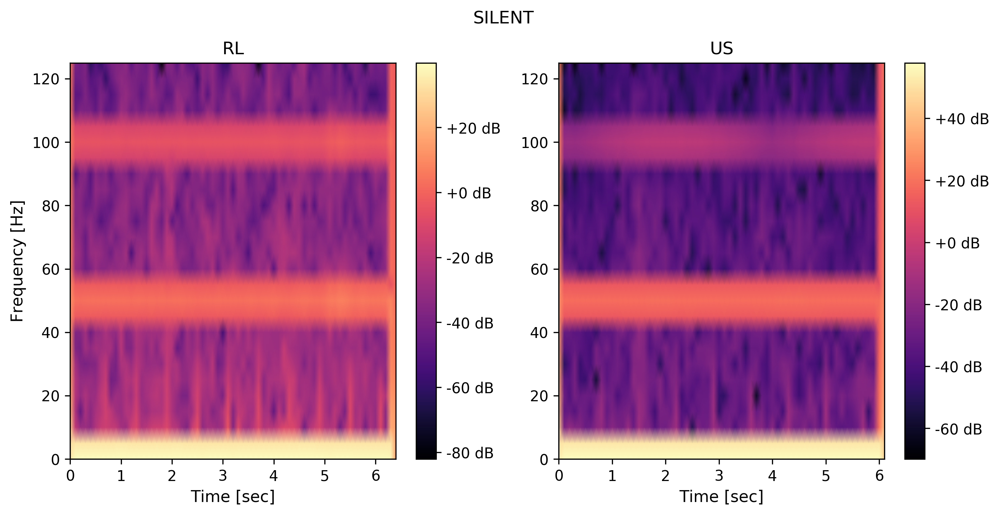

In [38]:
STFT(data1=get_sample(1, 'RL', SENTENCES[0]), data2=get_sample(1, 'US', SENTENCES[0]),MODE="SILENT")
STFT(data1=get_sample(1, 'RL', SENTENCES[1]), data2=get_sample(1, 'US', SENTENCES[1]),MODE="SILENT")
STFT(data1=get_sample(1, 'RL', SENTENCES[2]), data2=get_sample(1, 'US', SENTENCES[2]),MODE="SILENT")
STFT(data1=get_sample(1, 'RL', SENTENCES[3]), data2=get_sample(1, 'US', SENTENCES[3]),MODE="SILENT")
STFT(data1=get_sample(1, 'RL', SENTENCES[4]), data2=get_sample(1, 'US', SENTENCES[4]),MODE="SILENT")

### SPECTOGRAM

In [40]:
def SPECTOGRAM(data1,data2,MODE,channel=4):
    plt.suptitle(MODE)
    plt.subplot(121).set_title("RL")
    M = 50
    win = signal.windows.hamming(M)
    f, t, Sxx = signal.spectrogram(data1[:,channel], fs=SAMPLING_RATE, window = win, nperseg=M)
#     print(Sxx)
    plt.pcolormesh(t, f, 10*np.log10(Sxx), shading='gouraud',cmap="magma")
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
#     plt.ylim([0,20])
    plt.colorbar(format='%+2.0f dB')
    
    plt.subplot(122).set_title("US")
    win = signal.windows.hanning(M)    
    f, t, Sxx = signal.spectrogram(data2[:,channel], fs=SAMPLING_RATE, window = win, nperseg=M)
    plt.pcolormesh(t, f, 10*np.log10(Sxx), shading='gouraud',cmap="magma")
#     plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
#     plt.ylim([0,20])
    plt.colorbar(format='%+2.0f dB')
    plt.show()

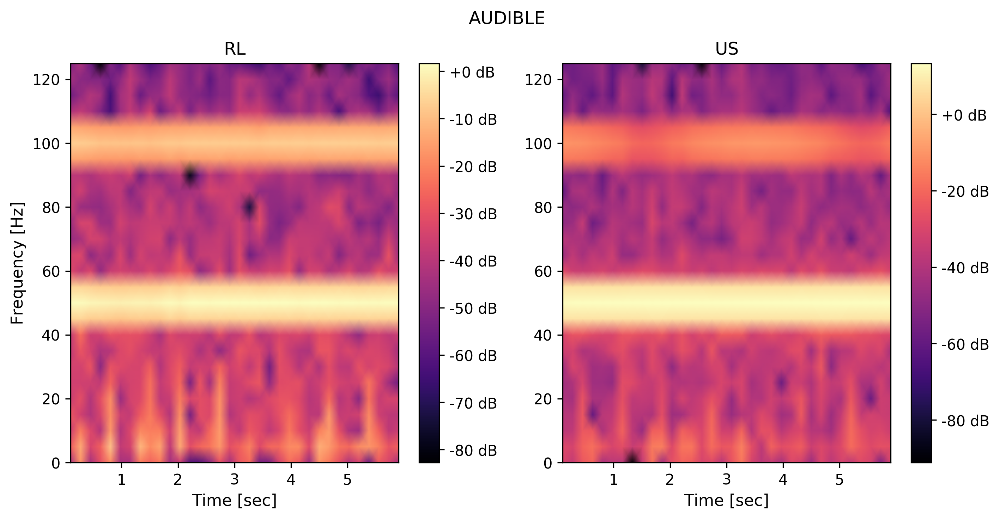

In [41]:
SPECTOGRAM(data1=get_sample(1, 'RL', SENTENCES[3]), data2=get_sample(1, 'US', SENTENCES[3]),MODE="AUDIBLE")

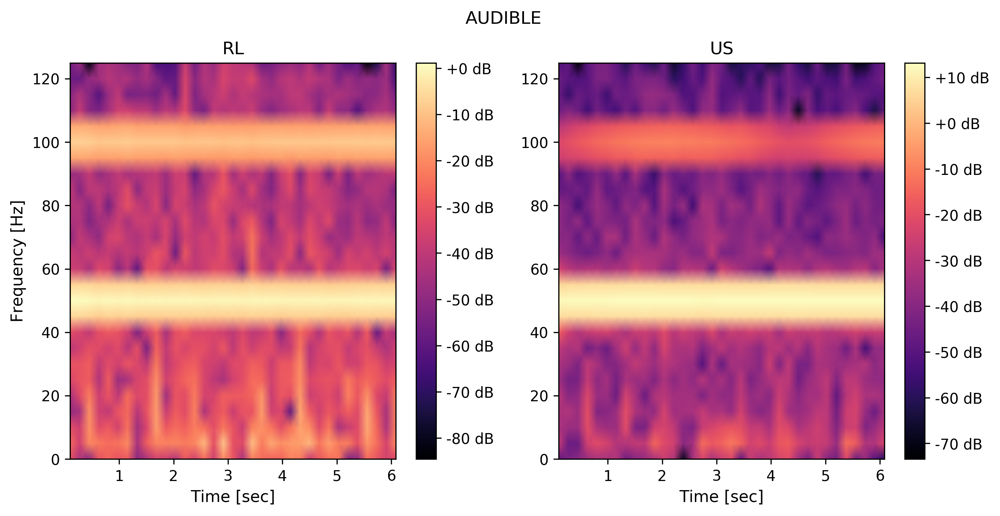

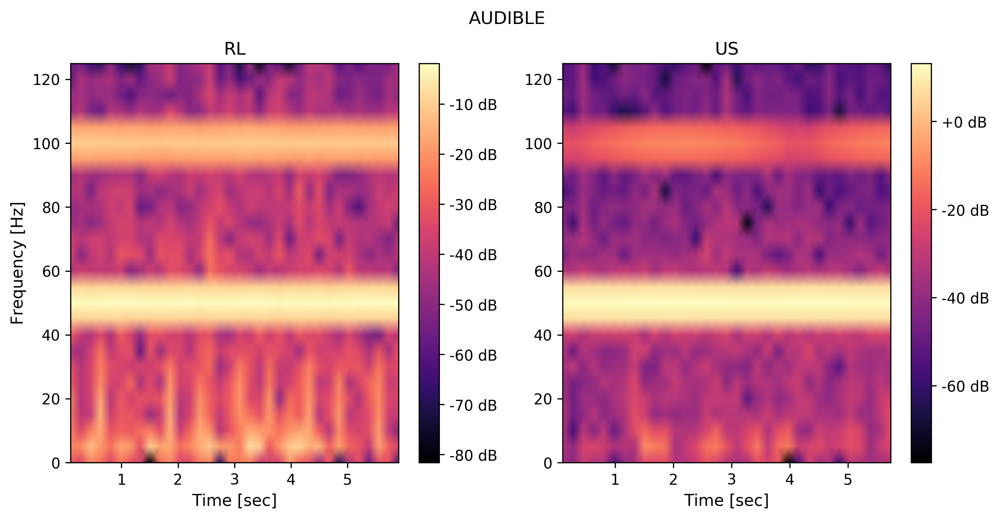

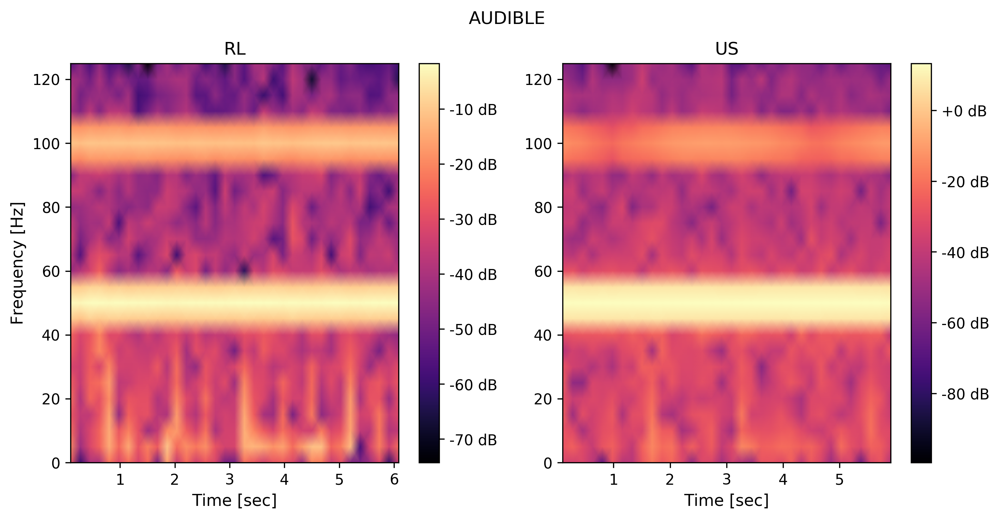

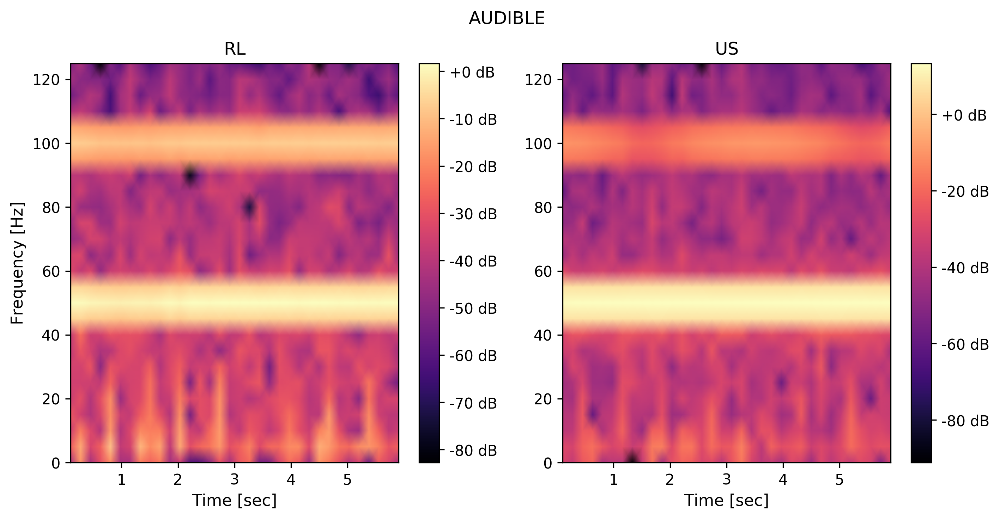

In [42]:
SPECTOGRAM(data1=get_sample(1, 'RL', SENTENCES[0]), data2=get_sample(1, 'US', SENTENCES[0]),MODE="AUDIBLE")
SPECTOGRAM(data1=get_sample(1, 'RL', SENTENCES[1]), data2=get_sample(1, 'US', SENTENCES[1]),MODE="AUDIBLE")
SPECTOGRAM(data1=get_sample(1, 'RL', SENTENCES[2]), data2=get_sample(1, 'US', SENTENCES[2]),MODE="AUDIBLE")
SPECTOGRAM(data1=get_sample(1, 'RL', SENTENCES[3]), data2=get_sample(1, 'US', SENTENCES[3]),MODE="AUDIBLE")

In [31]:
# Milxa ra bhanya? sorry...haha
# for i in range(NUM_CHANNELS):
#     f, t, sxx = signal.spectrogram(sample_US_audible[:,i], fs=SAMPLING_RATE, nperseg=50)
#     Sxx = Sxx + sxx


In [19]:
sample_sentence(2, "RL", "audible").shape
# librosa.feature.mfcc(y = np.asfortranarray(sample_sentence(1, "RL", "audible" )[:, 0]))
# np.asfortranarray(sample_sentence(1, "RL", "audible" )[:, 0]).shape
sample_sentence(1, "RL", "audible" )[:, 0].shape


(713,)

## MFCC


##### Don't know if this implementation is correct ??...

In [43]:
def MFCC(data1,data2,MODE,channel=4):
    
    #mfcc parameter
    n_mfcc = 40
    
    plt.suptitle(MODE)
    plt.subplot(121).set_title("RL")
    # Passing through arguments to the Mel filters  #n_fft = 100 <for unfiltered data>
    S = librosa.feature.melspectrogram(y=np.asfortranarray(data1[:, channel]),n_fft = 200, sr=SAMPLING_RATE,
                                       n_mels=128, fmax=250, hop_length=5, power = 1)
    display.specshow(librosa.power_to_db(S,ref=np.max),y_axis='mel', fmax = 250, x_axis="time")
    plt.colorbar(format='%+2.0f dB')
#     plt.ylabel('Frequency [Hz]')
#     plt.xlabel('Time [sec]')
    
    plt.subplot(122).set_title("US")
    # Passing through arguments to the Mel filters
    S = librosa.feature.melspectrogram(y=np.asfortranarray(data2[:, channel]),n_fft = 200, sr=SAMPLING_RATE,
                                       n_mels=128, fmax=250, hop_length=5, power=1)
    display.specshow(librosa.power_to_db(S,ref=np.max),y_axis='mel', fmax = 250, x_axis="time")
    plt.colorbar(format='%+2.0f dB')

#     plt.ylim([0,20])    
    plt.tight_layout()
    plt.show()

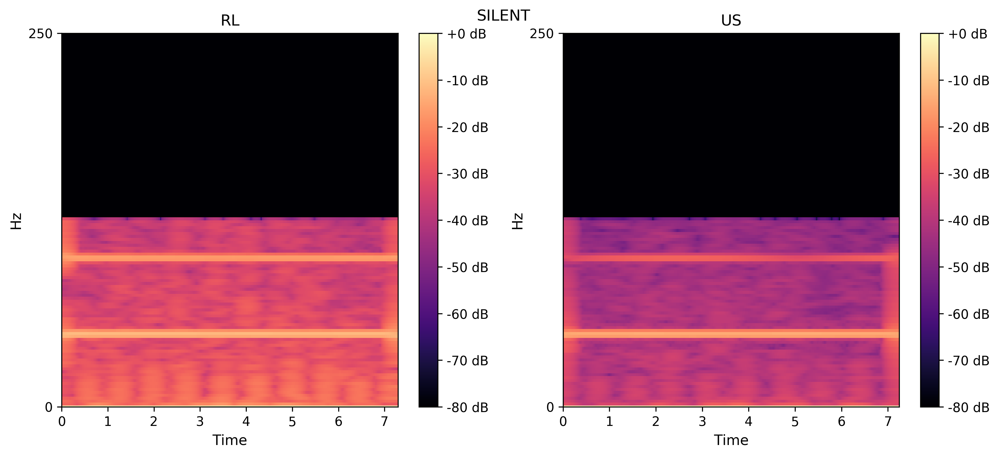

'\nsource : https://dsp.stackexchange.com/questions/3321/choosing-the-length-of-a-signal-when-calculating-the-fft\n'

In [44]:

MFCC(data1=get_sample(1, 'RL', SENTENCES[0]), data2=get_sample(1, 'US', SENTENCES[0]),MODE="SILENT")

'''
source : https://dsp.stackexchange.com/questions/3321/choosing-the-length-of-a-signal-when-calculating-the-fft
'''

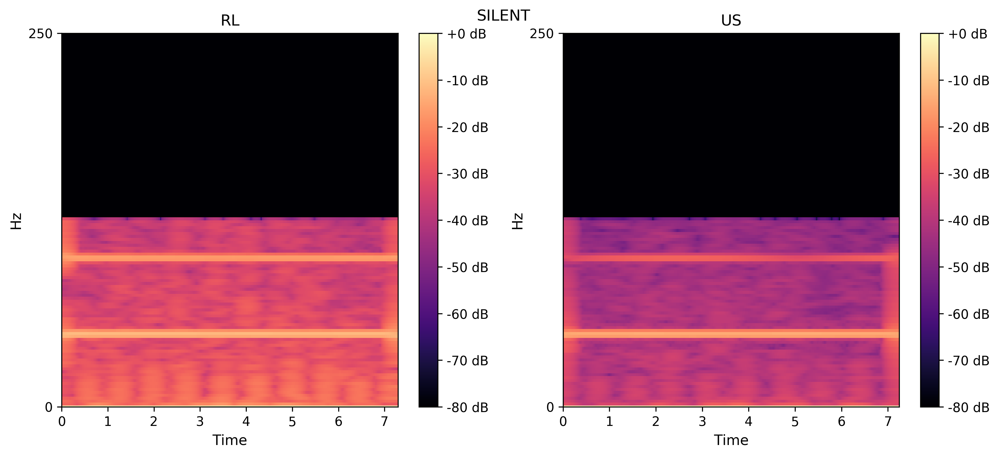

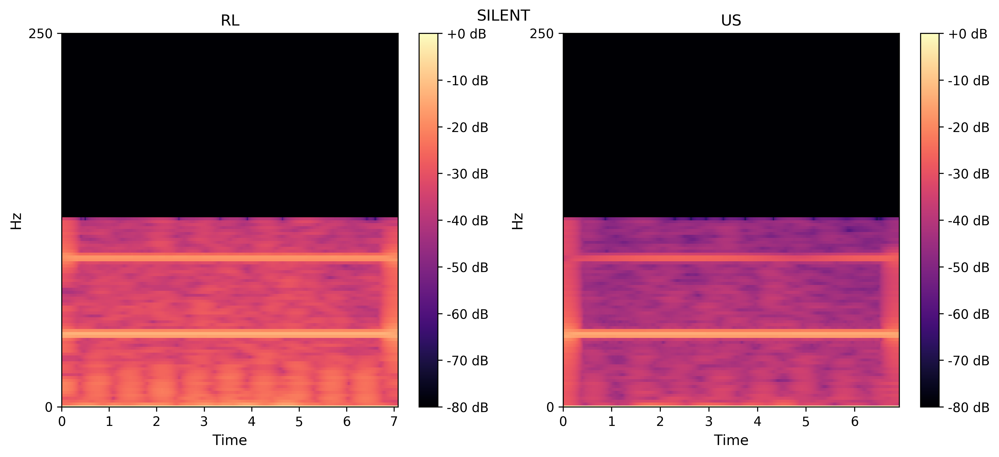

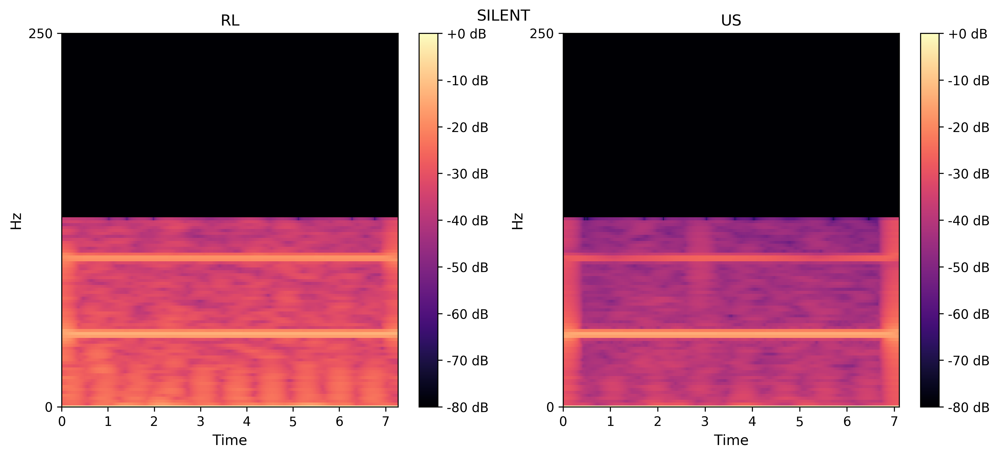

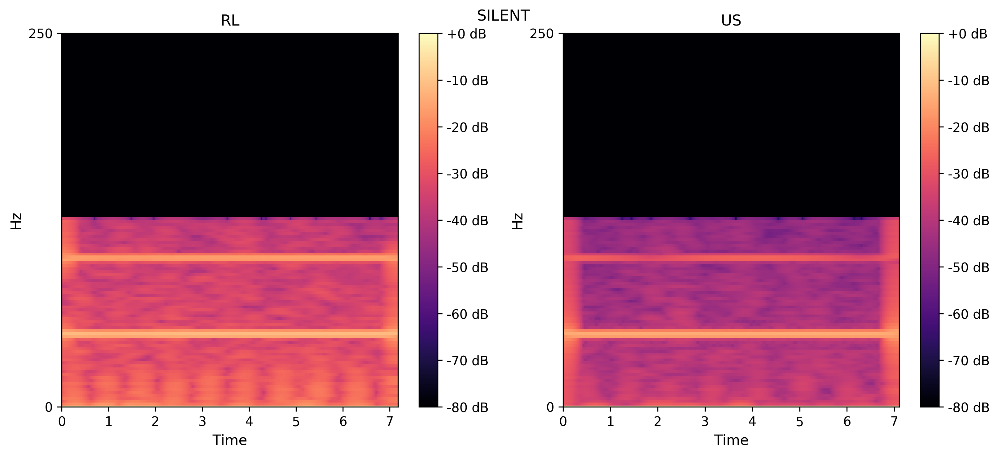

In [45]:
MFCC(data1=get_sample(1, 'RL', SENTENCES[0]), data2=get_sample(1, 'US', SENTENCES[0]),MODE="SILENT")
MFCC(data1=get_sample(1, 'RL', SENTENCES[1]), data2=get_sample(1, 'US', SENTENCES[1]),MODE="SILENT")
MFCC(data1=get_sample(1, 'RL', SENTENCES[2]), data2=get_sample(1, 'US', SENTENCES[2]),MODE="SILENT")
MFCC(data1=get_sample(1, 'RL', SENTENCES[3]), data2=get_sample(1, 'US', SENTENCES[3]),MODE="SILENT")



## SIGNAL ANALYSIS (FILTERED)

#### data access

In [32]:
def get_sample(index, speaker, label = "आजको मौसम बताउ"):
    return df.query('speaker=="'+speaker+'" and labels=="'+ label+'"')["data"].iloc[index]

In [46]:
class Preprocess():
    """
    something something
    """
    
    pass

In [44]:
def preprocess_data(data):
    #correct dc drift
    
    #correct dc bias
    
    #normalize data
    
    #filter data
    def digital_filter(data,HPF=0.5,LPF=10,H_ORDER=4,L_ORDER=4,SR=SAMPLING_RATE):
        # Highpass filter
        f_signal = biosppy.signals.tools.filter_signal(data,
                                                     ftype="butter",
                                                     band="highpass",
                                                     order=H_ORDER,
                                                     sampling_rate=SR,
                                                     frequency=HPF)

        b,a = signal.iirnotch(50,30,SR)
        f_signal = signal.lfilter(b,a,f_signal[0])
        # Lowpass filter
        f_signal = biosppy.signals.tools.filter_signal(f_signal,
                                                     ftype="butter",
                                                     band="lowpass",
                                                     order=L_ORDER,
                                                     sampling_rate=SR,
                                                     frequency=LPF)
        return f_signal[0]
    
    f_data = []
    for i in range(NUM_CHANNELS):
        c_data = data[:,i]- data[0,i]
        c_data = c_data - np.mean(c_data)
        c_data = digital_filter(c_data)
        f_data.append(c_data)
    
    return np.array(f_data).T

In [35]:
# sample_RL_audible = preprocess_data(sample_RL_audible)
# sample_RL_mouthed = preprocess_data(sample_RL_mouthed)
# sample_RL_mentally = preprocess_data(sample_RL_mentally)

# sample_US_audible = preprocess_data(sample_US_audible)
# sample_US_mouthed = preprocess_data(sample_US_mouthed)
# sample_US_mentally = preprocess_data(sample_US_mentally)

### TIME SERIES PLOT - SILENT

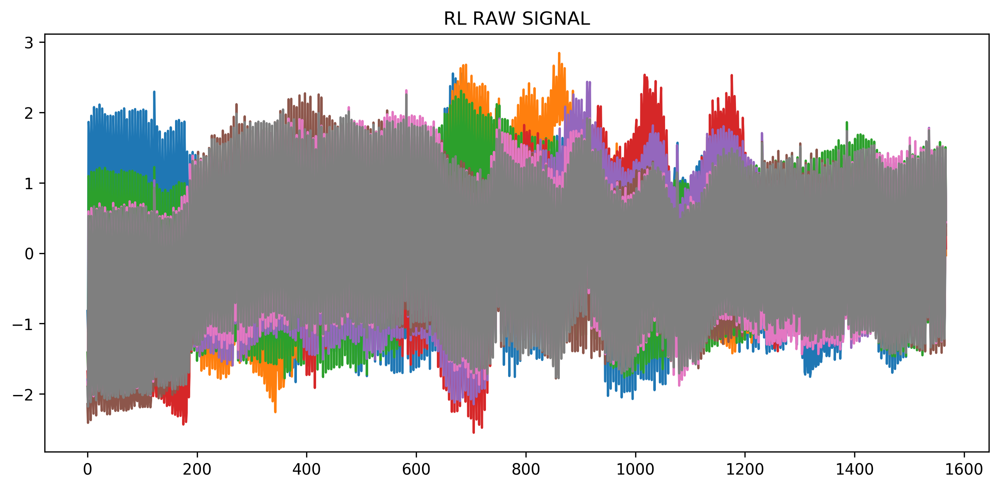

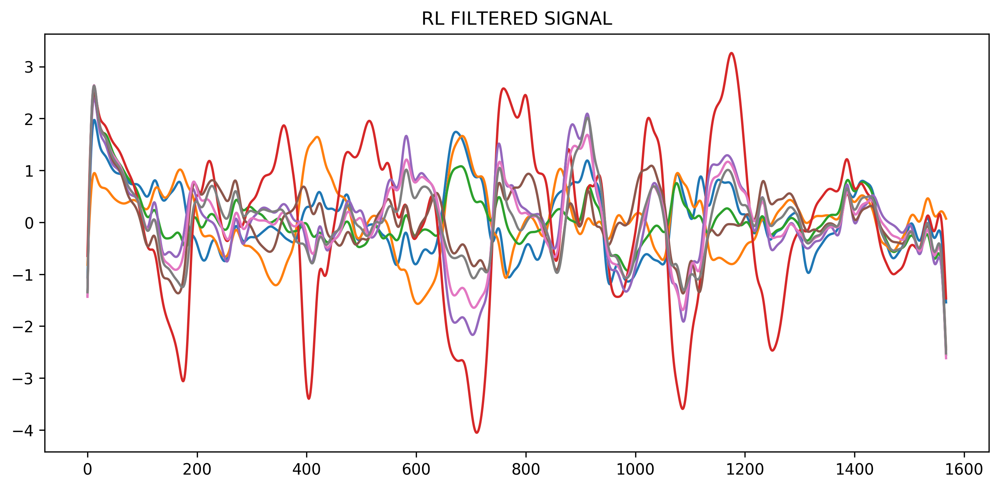

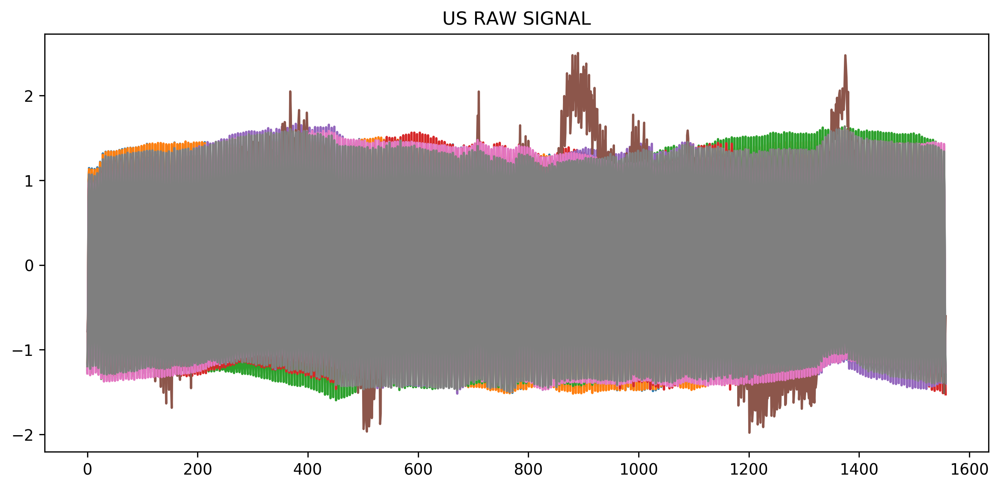

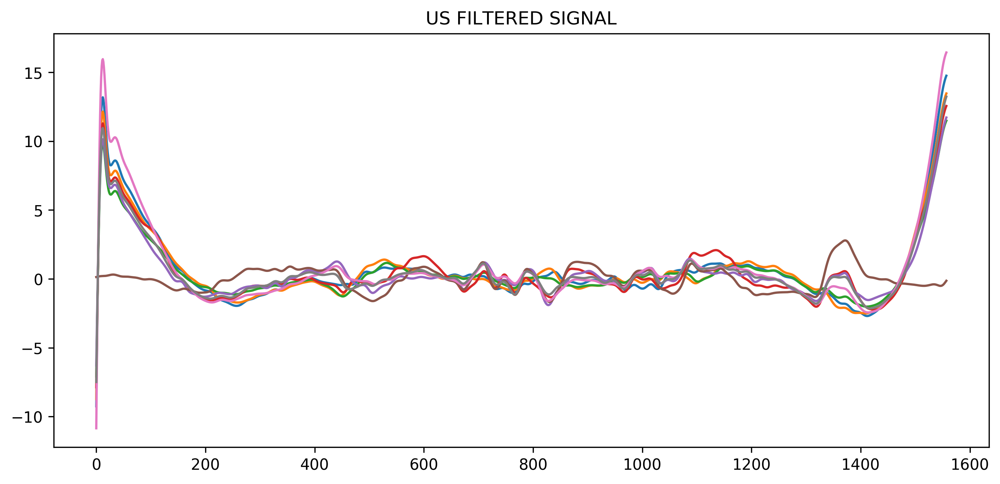

In [49]:
f_signals = preprocess_data(get_sample(1, 'RL', SENTENCES[0]))

plt.title("RL RAW SIGNAL")
plt.plot(zscore(get_sample(1, 'RL', SENTENCES[0]),axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()


f_signals = preprocess_data(get_sample(1, 'US', SENTENCES[0]))

plt.title("US RAW SIGNAL")
plt.plot(zscore(get_sample(1, 'US', SENTENCES[0]),axis=0))
plt.show()

plt.title("US FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()

### FFT

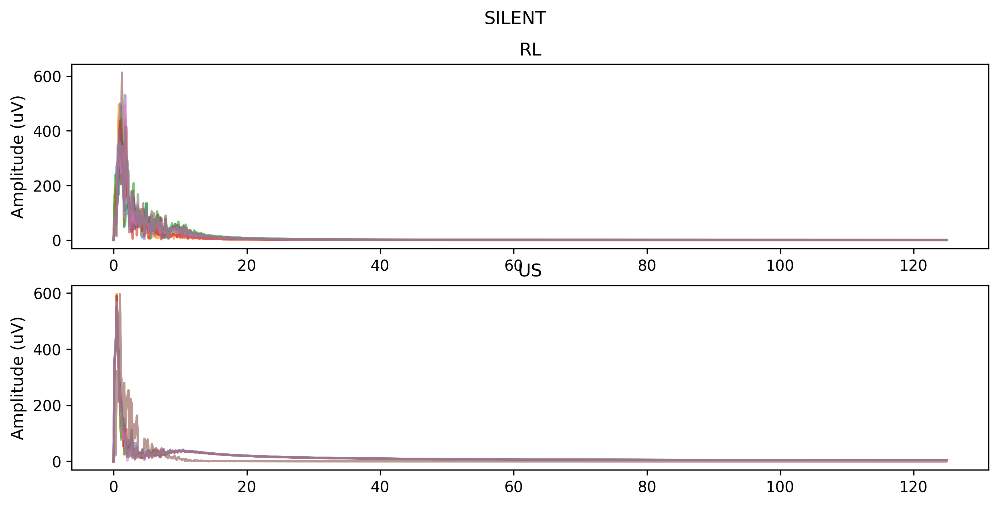

In [51]:

FFT(data1=preprocess_data(get_sample(1, 'RL', SENTENCES[0])),data2=preprocess_data(get_sample(1, 'US', SENTENCES[0])),MODE="SILENT")


### POWER SPECTRUM

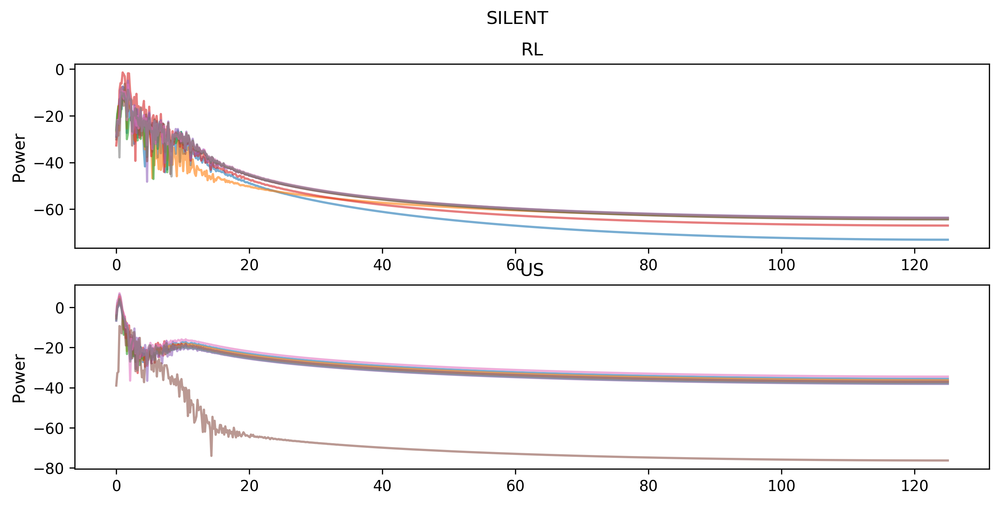

In [52]:
power_spec(data1=preprocess_data(get_sample(1, 'RL', SENTENCES[0])),data2=preprocess_data(get_sample(1, 'US', SENTENCES[0])),MODE="SILENT")


### STFT

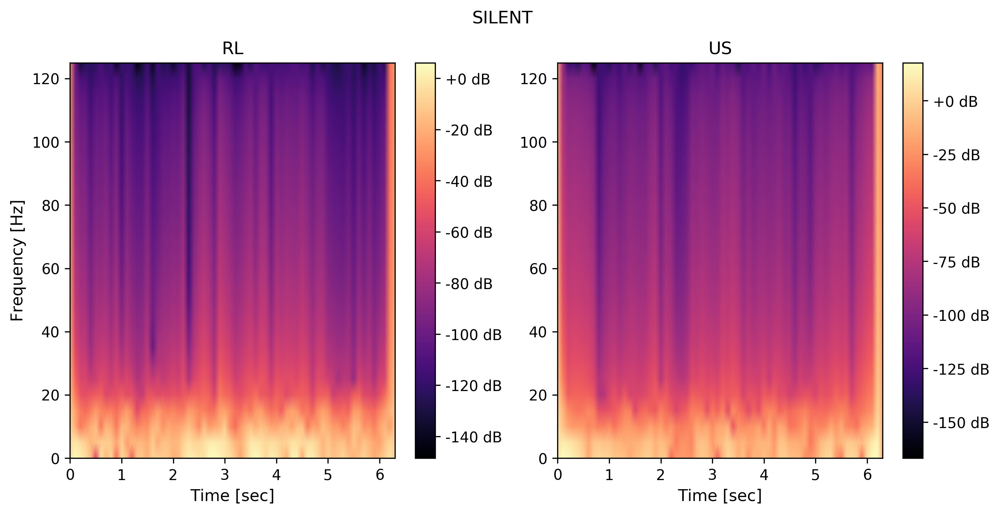

In [53]:
STFT(data1=preprocess_data(get_sample(1, 'RL', SENTENCES[0])),data2=preprocess_data(get_sample(1, 'US', SENTENCES[0])),MODE="SILENT")

### SPECTOGRAM

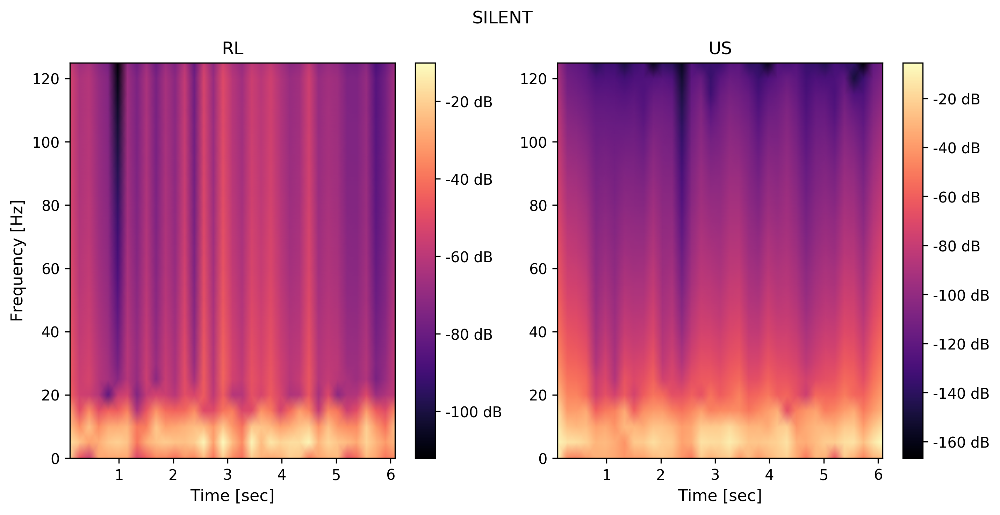

In [54]:
SPECTOGRAM(data1=preprocess_data(get_sample(1, 'RL', SENTENCES[0])),data2=preprocess_data(get_sample(1, 'US', SENTENCES[0])),MODE="SILENT")


## MFCC

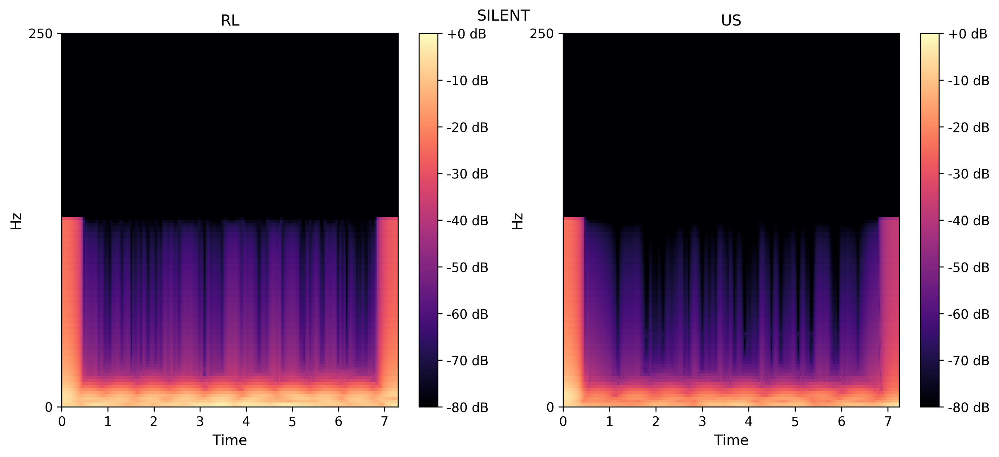

In [55]:
MFCC(data1=preprocess_data(get_sample(1, 'RL', SENTENCES[0])), data2=preprocess_data(get_sample(1, 'US', SENTENCES[0])),MODE="SILENT")

In [52]:
df_data.tail(10)

,Channel 1,Channel 2,Channel 3,Channel 4,Channel 5,Channel 6,Channel 7,Channel 8
494,-529.321177,158.146526,45.192360,58.771500,-260.103998,-1434.831032,40.609524,660.518278
495,-531.690812,152.811794,39.011802,52.583947,-266.907048,-1435.491020,33.165476,666.881671
496,-532.587588,151.032222,37.050870,50.597037,-269.374078,-1435.202718,30.773389,672.259404
497,-530.061623,156.810093,43.802470,57.261208,-262.490592,-1433.685942,38.704548,669.167835
498,-527.726476,161.877543,49.584349,63.114025,-256.063222,-1433.316265,45.523096,661.344113
499,-529.191782,158.252948,45.260804,58.853436,-260.440213,-1434.796108,40.492616,660.536264
500,-531.511430,152.979661,39.162183,52.789784,-267.008460,-1435.283655,33.267895,667.045074
501,-532.478667,151.093165,37.147292,50.769401,-269.432533,-1434.986883,30.897792,672.389280
502,-529.827279,156.977458,44.030287,57.578454,-262.075906,-1433.225287,39.162682,669.420165
503,-527.599089,161.931502,49.630308,63.176474,-255.686516,-1433.053458,45.648993,661.554927


In [53]:
df_data.describe()

,Channel 1,Channel 2,Channel 3,Channel 4,Channel 5,Channel 6,Channel 7,Channel 8
count,504.000000,504.000000,504.000000,504.000000,504.000000,504.000000,504.000000,504.000000
mean,-530.844454,156.224017,42.840729,57.101713,-263.102366,-1434.588300,37.045424,664.135940
std,1.823939,3.869028,4.478688,4.478628,4.811607,0.966129,5.269966,4.712148
min,-534.217781,150.296306,36.101129,49.719240,-270.833905,-1436.521732,28.777486,655.284957
25%,-532.491906,152.992398,39.075626,52.775170,-267.002092,-1435.347153,32.990368,660.036656
50%,-530.887437,155.891085,42.577201,56.922979,-263.546734,-1434.828282,36.608474,663.795406
75%,-529.169059,159.655572,46.551647,61.130990,-258.654392,-1433.730078,41.104128,668.138182
max,-527.566085,162.071888,49.630308,64.443463,-255.239372,-1432.519373,45.876312,672.447735


In [14]:
df.describe()

,data,speaker,labels,session,filename
count,1305,1305,1305,1305,1305
unique,1305,2,5,6,87
top,"[[161.4583826837344, 535.0485936377383, -28.49...",US,पङ्खाको स्तिथी बदल,session2,OpenBCI-RAW-2021-06-07_14-44-20.txt
freq,1,735,261,300,15


In [15]:
df["data"].iloc[1]

array([[-297.5590387 ,  376.81465746,  157.27372794, ...,  674.7084048 ,
         -44.29557503,  154.16621337],
       [-292.52956878,  379.22074417,  163.76853588, ...,  681.07035738,
         -37.41407809,  160.71347369],
       [-293.23899656,  378.05317111,  162.53401673, ...,  680.04318121,
         -38.90288926,  159.54341226],
       ...,
       [-300.04804951,  367.94773789,  152.29221386, ...,  670.33641232,
         -48.91388418,  149.98405792],
       [-300.35529868,  368.31396599,  152.07288737, ...,  670.11110498,
         -49.00630886,  149.91711182],
       [-294.85620202,  371.02878617,  159.28361688, ...,  676.86622125,
         -41.54627499,  156.84156875]])

In [17]:
len(df["data"].iloc[:])

1305

In [46]:
for i in range(len(df["data"].iloc[:])):
    df["data"].iloc[i] = preprocess_data(df["data"].iloc[i])

In [47]:
df["data"].iloc[1]

array([[ 0.11322394, -0.4668974 ,  0.01929745, ...,  0.07045034,
        -0.03107986,  0.02946429],
       [ 0.05133666, -0.46268377, -0.01705473, ...,  0.02871043,
        -0.05541618, -0.01636029],
       [-0.0108866 , -0.45934841, -0.05449075, ..., -0.01391925,
        -0.08105541, -0.06316574],
       ...,
       [ 0.51321894,  0.4574632 ,  0.68363897, ...,  0.7799205 ,
         0.56075053,  0.87663367],
       [ 0.57781163,  0.52359682,  0.75199163, ...,  0.83449204,
         0.62986879,  0.95191197],
       [ 0.64567967,  0.59137725,  0.82226798, ...,  0.89299846,
         0.70234458,  1.03103569]])

In [48]:
df_pickleDataFile = 'new_data_dict_dataframe_equalmaxlen_preprocess.pickle'
df_dataNeedsUpdate = True
if df_pickleDataFile in os.listdir(PICKLE_DIR) and not df_dataNeedsUpdate:
    df = pd.read_pickle(os.path.join(PICKLE_DIR, df_pickleDataFile))
else :
#     df = pd.DataFrame(parsedData)
    df.to_pickle(os.path.join(PICKLE_DIR, df_pickleDataFile))